## Test Machine Learning Module 


The purpose of this notebook is to inspect whether the deployed machine learning module has any issue.

In [04_DeployOnIOTedge.ipynb](04_DeployOnIOTedge.ipynb) we deployed two modules: the people-detection module and image-capture module. In this context, this notebook aims to verify whether the people-detection module can receive a single image as input and output expected prediction result.

In [4]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import requests
import json
import time
import matplotlib.pyplot as plt
from PIL import Image,ImageDraw, ImageFont
from IPython.display import display

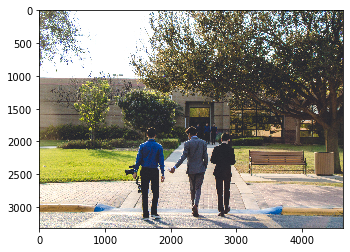

In [3]:
img_path = "./test_image.jpg"
img = Image.open(img_path).convert("RGB")
plt.imshow(img)

In [5]:
scoring_url = 'http://127.0.0.1:80/image'

In [6]:
img_data = open(img_path, 'rb').read()

In [7]:
type(img_data)

bytes

In [8]:
%time r = requests.post(scoring_url, files={'imageData':img_data})
r.json()

CPU times: user 6.98 ms, sys: 326 µs, total: 7.3 ms
Wall time: 570 ms


{'created': '2019-09-24T17:05:34.624155',
 'id': '',
 'iteration': '',
 'predictions': [{'boundingBox': {'height': 0.39464531,
    'left': 0.29475544,
    'top': 0.55886266,
    'width': 0.15267555},
   'probability': 0.96830207,
   'tagId': 0,
   'tagName': 'person'},
  {'boundingBox': {'height': 0.40051704,
    'left': 0.42229218,
    'top': 0.55124408,
    'width': 0.11991112},
   'probability': 0.79053777,
   'tagId': 0,
   'tagName': 'person'},
  {'boundingBox': {'height': 0.37831635,
    'left': 0.5237456,
    'top': 0.56706404,
    'width': 0.13119711},
   'probability': 0.64390785,
   'tagId': 0,
   'tagName': 'person'},
  {'boundingBox': {'height': 0.22768353,
    'left': 0.44303363,
    'top': 0.54745965,
    'width': 0.08719815},
   'probability': 0.52546048,
   'tagId': 0,
   'tagName': 'person'},
  {'boundingBox': {'height': 0.08759357,
    'left': 0.78762015,
    'top': 0.86854065,
    'width': 0.03344009},
   'probability': 0.13892619,
   'tagId': 0,
   'tagName': 'perso

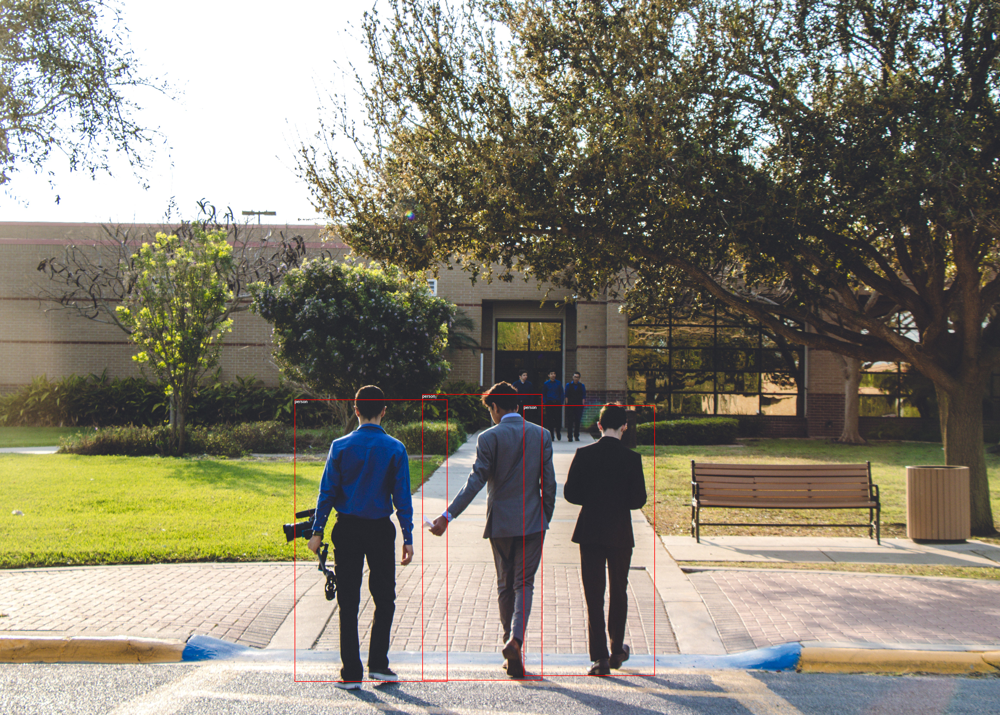

In [9]:
# Plot the image annotated with the prediction results

img = Image.open(img_path).convert("RGB") # type: PIL.Image.Image
w,h = img.size
results = r.json()
preds = results['predictions']
draw = ImageDraw.Draw(img)

font_size = 20
# need to locate a font ttf file from the local compute
font_path = "/usr/share/fonts/truetype/lato/Lato-Bold.ttf"
font = ImageFont.truetype(font_path, font_size)

for i in range(len(preds)):
# draw box only if a person is detected
    if(preds[i]['probability']>0.60):
        ymin=preds[i]['boundingBox']['top']
        xmin=preds[i]['boundingBox']['left']
        ymax=preds[i]['boundingBox']['height']
        xmax=preds[i]['boundingBox']['width']
             
        draw.rectangle(
            ((xmin * w, ymin * h), 
             ((xmin+xmax) * w,
              (ymin+ymax) * h)), outline="red", width=3
        )
        label_text = preds[i]['tagName']
        draw.text((xmin * w, ymin * h), label_text, (255,255,255), font)

display(img)

Next we will proceed to notebook [06_TearDown.ipynb](06_TearDown.ipynb).